_GAN model on CelebA dataset_

_16/3/2025_

__Nu Aim Mohammed Chemnad Lasiyath__

__CS22B1024__

- Train a GAN model on celebrity faces dataset.
    1. Use basic layers from the frameworks to write the discriminator and generator. 
    1. Understand the flow of data from input to output while training and testing.
    1. Visualize samples from the dataset after loading the dataset. 
    1. After each epoch, plot a few samples to track the training progress.
    1. Generate 50 samples from the trained model. 

Dataset: CelebA

Use only images from the dataset to train the GAN model, resize the image to 64x64 for training to minimize computational requirements.

In [1]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np

2025-03-16 10:44:17.958846: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1742121860.350587    4310 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1742121861.017421    4310 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-16 10:44:27.028195: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
# image_dir = "/kaggle/input/celeba/img_align_celeba"

def load_image(image_path):
    image=image_path["image"]
    # image = tf.io.read_file(image_path)
    # image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, (64, 64))
    image = tf.cast(image, tf.float32) / 255.0  # Normalize
    return image

# image_paths = tf.data.Dataset.list_files(image_dir + "/*.jpg")
celebA_dataset = tfds.load('celeb_a',split='train',download=False)
celebA_dataset = celebA_dataset.map(load_image)

I0000 00:00:1742121950.565515    4310 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 5563 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 4060 Laptop GPU, pci bus id: 0000:01:00.0, compute capability: 8.9


2025-03-16 10:45:51.842574: I tensorflow/core/kernels/data/tf_record_dataset_op.cc:376] The default buffer size is 262144, which is overridden by the user specified `buffer_size` of 8388608
2025-03-16 10:45:52.165780: I tensorflow/core/framework/local_rendezvous.cc:405] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


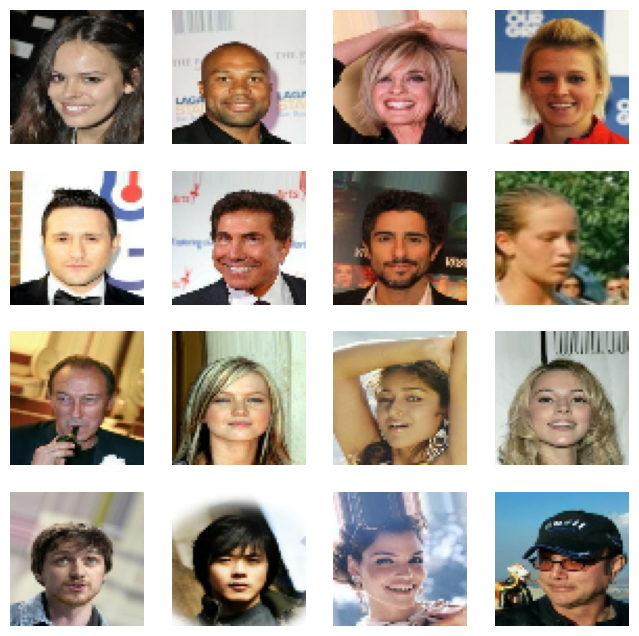

In [3]:
def visualize_data(dataset):
    plt.figure(figsize=(8, 8))
    for i, image in enumerate(dataset.take(16)):
        # display(image["image"].shape)
        plt.subplot(4, 4, i + 1)
        plt.imshow(image)  # De-normalize for visualization
        plt.axis('off')
    plt.show()

visualize_data(celebA_dataset)

In [4]:
class Discriminator(tf.keras.Model):
    def __init__(self,LATENT_DIM):
        super(Discriminator,self).__init__()

        self.discriminator=tf.keras.models.Sequential([
            tf.keras.layers.InputLayer(shape=(64, 64, 3)),
            tf.keras.layers.Conv2D(32,(3,3),strides=2,activation="relu"),
            tf.keras.layers.Conv2D(64,(3,3),strides=2,activation="relu"),
            tf.keras.layers.Conv2D(128,(3,3),strides=2,activation="relu"),
            tf.keras.layers.Conv2D(256,(3,3),strides=2,activation="relu"),
            tf.keras.layers.Flatten(),
            tf.keras.layers.Dense(LATENT_DIM)
        ])

    def call(self,inputs):
        return self.discriminator(inputs)
    
class Generator(tf.keras.Model):
    def __init__(self,LATENT_DIM):
        super(Generator,self).__init__()

        self.generator=tf.keras.Sequential([
            tf.keras.layers.InputLayer(shape=(LATENT_DIM,)),
            tf.keras.layers.Dense(3*3*256,activation="relu"),
            tf.keras.layers.Reshape(target_shape=(3,3,256)),
            tf.keras.layers.Conv2DTranspose(128,(3,3),strides=2,activation="relu",padding="valid"),
            tf.keras.layers.Conv2DTranspose(64,(3,3),strides=2,activation="relu",padding="valid"),
            tf.keras.layers.Conv2DTranspose(32,(3,3),strides=2,activation="relu",padding="valid"),
            tf.keras.layers.Conv2DTranspose(3,(3,3),strides=2,activation="relu",padding="valid")
        ])

    def call(self,inputs):
        return self.generator(inputs)
    
Discriminator(64).discriminator.summary()
Generator(64).generator.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 31, 31, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 15, 15, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 7, 7, 128)      │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 3, 3, 256)      │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 2304)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │       147,520 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 535,936 (2.04 MB)

 Trainable params: 535,936 (2.04 MB)

 Non-trainable params: 0 (0.00 B)

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_1 (Dense)                 │ (None, 2304)           │       149,760 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 3, 3, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 7, 7, 128)      │       295,040 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 15, 15, 64)     │        73,792 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 31, 31, 32)     │        18,464 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_3              │ (None, 63, 63, 3)      │           867 │
│ (Conv2DTranspose)               │                        │               │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 537,923 (2.05 MB)

 Trainable params: 537,923 (2.05 MB)

 Non-trainable params: 0 (0.00 B)

In [5]:
class GAN(tf.keras.Model):
    def __init__(self,discriminator,generator,latent_dim):
        super(GAN,self).__init__()
        self.discriminator=discriminator
        self.generator=generator
        self.latent_dim=latent_dim
    
    def compile(self,disc_optimizer,gen_optimizer,loss_fn,batch_size):
        super(GAN,self).compile()
        self.disc_optimizer=disc_optimizer
        self.gen_optimizer=gen_optimizer
        self.loss_fn=loss_fn
        self.batch_size=batch_size
        # self.generator_loss=generator_loss
        # self.discriminator_loss=discriminator_loss

    @tf.function
    def train_step(self,inputs):
        images=inputs
        noise=tf.random.normal([self.batch_size,self.latent_dim])

        with tf.GradientTape(persistent=True) as tape:
            generated_image=self.generator(noise)
            real_output=self.discriminator(images)
            fake_output=self.discriminator(generated_image)

            gen_loss=self.loss_fn(tf.ones_like(fake_output),fake_output)
            disc_loss=self.loss_fn(tf.ones_like(real_output),real_output)+self.loss_fn(tf.zeros_like(fake_output),fake_output)

        grad_disc=tape.gradient(disc_loss,self.discriminator.trainable_variables)
        grad_gen=tape.gradient(gen_loss,self.generator.trainable_variables)

        self.disc_optimizer.apply_gradients(zip(grad_disc,self.discriminator.trainable_variables))
        self.gen_optimizer.apply_gradients(zip(grad_gen,self.generator.trainable_variables))

        return {"Gen Loss":gen_loss,"Disc Loss":disc_loss}

In [6]:
class Training_Callback(tf.keras.callbacks.Callback):
    def __init__(self,latent_dim):
        super(Training_Callback,self).__init__()
        self.latent_dim=latent_dim

    def show_imgs(self):
        seed=tf.random.normal([4,self.latent_dim])
        gen_imgs=self.model.generator(seed)

        plt.figure(figsize=(8,8))
        for i in range(gen_imgs.shape[0]):
            plt.subplot(1,4,i+1)
            plt.imshow(gen_imgs[i])
            plt.axis('off')
        plt.show()
    
    def on_epoch_end(self,epoch,logs=None):
        self.show_imgs()

In [ ]:
LATENT_DIM=64
epochs=500

batch_size=1250

buffer_size=5000

gen_optimizer=tf.keras.optimizers.Adam(0.0001)
disc_optimizer=tf.keras.optimizers.Adam(0.0001)

celebA_dataset=celebA_dataset.shuffle(buffer_size,reshuffle_each_iteration=True).batch(batch_size).prefetch(tf.data.AUTOTUNE)
cross_entropy=tf.keras.losses.BinaryCrossentropy(from_logits=True)

163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - Disc Loss: 0.1486 - Gen Loss: 4.5772

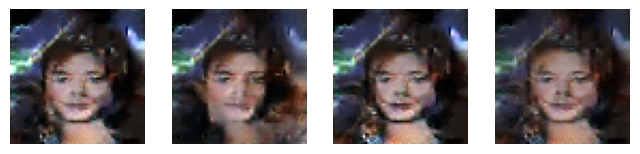

163/163 ━━━━━━━━━━━━━━━━━━━━ 41s 181ms/step - Disc Loss: 0.1489 - Gen Loss: 4.5800
Epoch 393/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1580 - Gen Loss: 4.9151

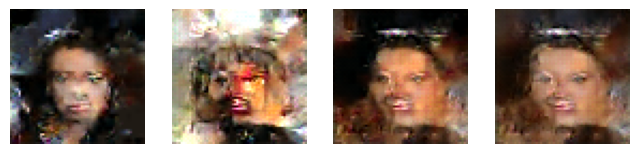

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.1575 - Gen Loss: 4.9146
Epoch 394/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1431 - Gen Loss: 4.7638

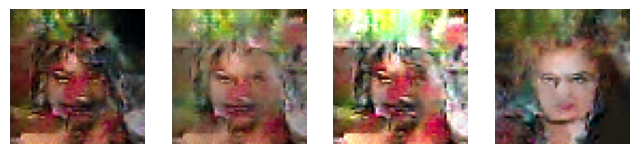

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 181ms/step - Disc Loss: 0.1430 - Gen Loss: 4.7630
Epoch 395/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - Disc Loss: 0.1614 - Gen Loss: 4.9830

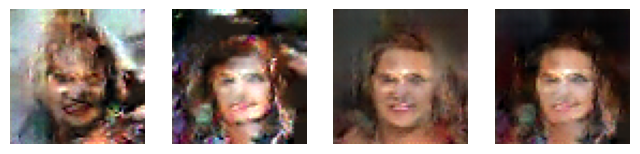

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 185ms/step - Disc Loss: 0.1622 - Gen Loss: 4.9835
Epoch 396/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1417 - Gen Loss: 4.3908

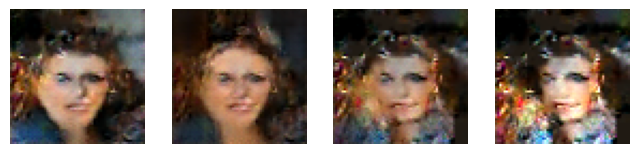

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 181ms/step - Disc Loss: 0.1416 - Gen Loss: 4.3861
Epoch 397/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.1421 - Gen Loss: 4.5115

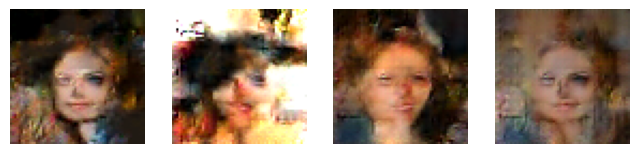

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 176ms/step - Disc Loss: 0.1421 - Gen Loss: 4.5072
Epoch 398/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1397 - Gen Loss: 4.3547

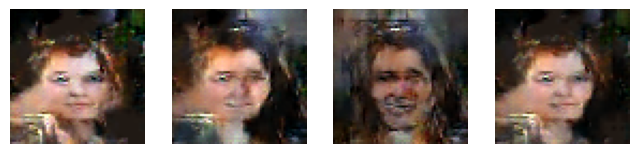

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 181ms/step - Disc Loss: 0.1399 - Gen Loss: 4.3542
Epoch 399/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1572 - Gen Loss: 4.9005

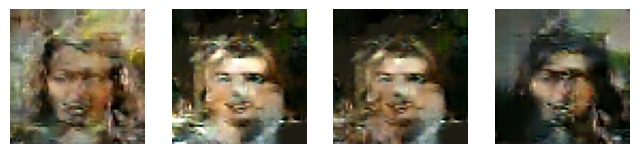

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.1573 - Gen Loss: 4.8990
Epoch 400/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - Disc Loss: 0.2104 - Gen Loss: 5.4708

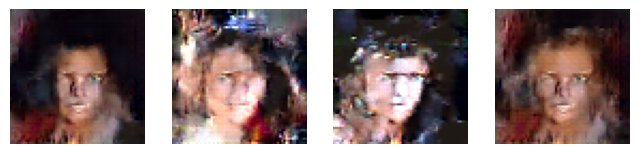

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 183ms/step - Disc Loss: 0.2102 - Gen Loss: 5.4748
Epoch 401/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - Disc Loss: 0.1688 - Gen Loss: 4.7380

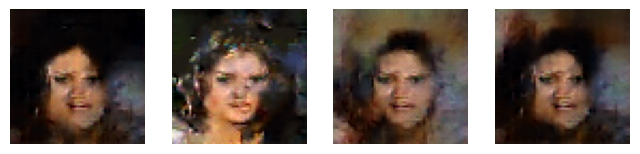

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 182ms/step - Disc Loss: 0.1689 - Gen Loss: 4.7381
Epoch 402/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - Disc Loss: 0.1691 - Gen Loss: 4.5919

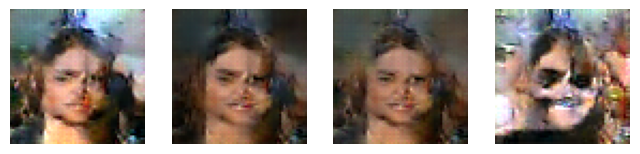

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 182ms/step - Disc Loss: 0.1688 - Gen Loss: 4.5911
Epoch 403/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.1565 - Gen Loss: 4.3278

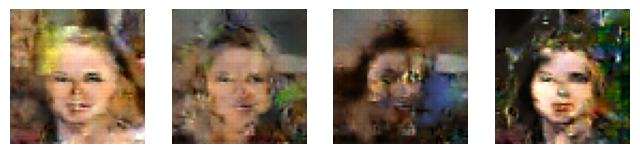

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 177ms/step - Disc Loss: 0.1565 - Gen Loss: 4.3257
Epoch 404/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - Disc Loss: 0.1458 - Gen Loss: 4.6055

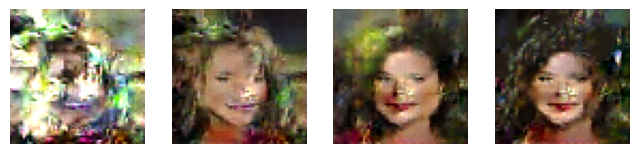

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 171ms/step - Disc Loss: 0.1452 - Gen Loss: 4.6079
Epoch 405/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - Disc Loss: 0.1660 - Gen Loss: 4.9327

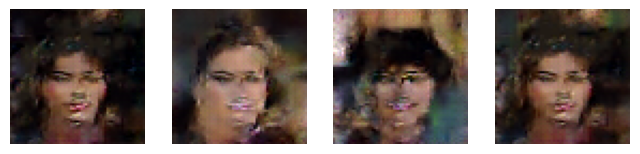

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 180ms/step - Disc Loss: 0.1656 - Gen Loss: 4.9414
Epoch 406/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step - Disc Loss: 0.1443 - Gen Loss: 5.1407

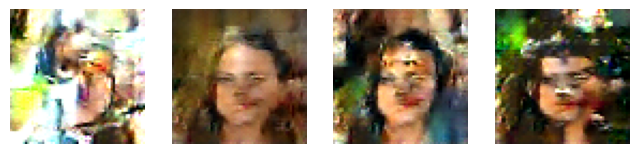

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 186ms/step - Disc Loss: 0.1443 - Gen Loss: 5.1342
Epoch 407/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1466 - Gen Loss: 4.4299

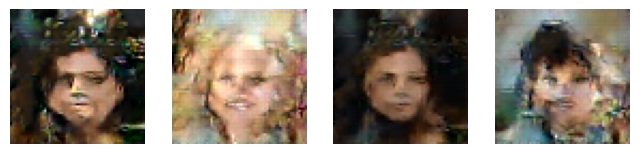

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 181ms/step - Disc Loss: 0.1465 - Gen Loss: 4.4304
Epoch 408/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - Disc Loss: 0.1928 - Gen Loss: 4.9466

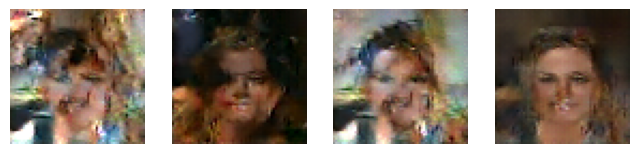

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 185ms/step - Disc Loss: 0.1931 - Gen Loss: 4.9462
Epoch 409/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step - Disc Loss: 0.1699 - Gen Loss: 4.5054

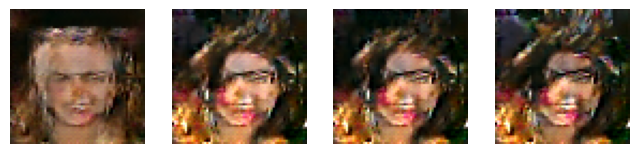

163/163 ━━━━━━━━━━━━━━━━━━━━ 43s 187ms/step - Disc Loss: 0.1701 - Gen Loss: 4.5077
Epoch 410/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step - Disc Loss: 0.1851 - Gen Loss: 4.4965

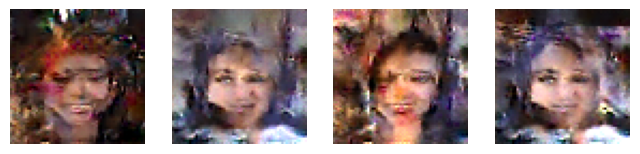

163/163 ━━━━━━━━━━━━━━━━━━━━ 33s 190ms/step - Disc Loss: 0.1845 - Gen Loss: 4.4982
Epoch 411/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1770 - Gen Loss: 4.3914

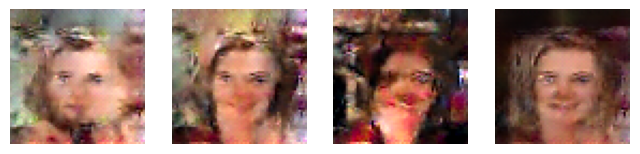

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 182ms/step - Disc Loss: 0.1775 - Gen Loss: 4.3907
Epoch 412/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - Disc Loss: 0.1646 - Gen Loss: 4.2864

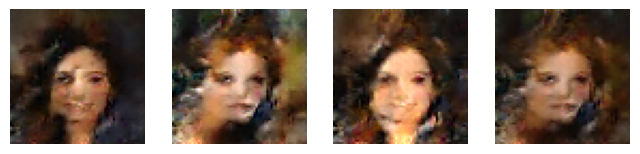

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 183ms/step - Disc Loss: 0.1647 - Gen Loss: 4.2865
Epoch 413/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - Disc Loss: 0.1457 - Gen Loss: 4.3854

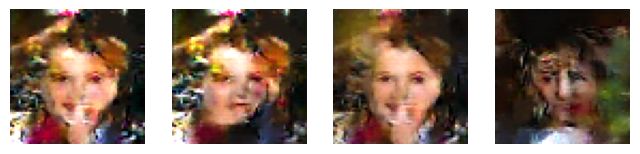

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 182ms/step - Disc Loss: 0.1462 - Gen Loss: 4.3881
Epoch 414/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - Disc Loss: 0.1606 - Gen Loss: 4.5130

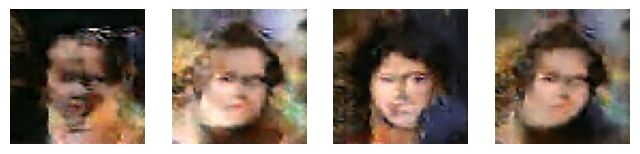

163/163 ━━━━━━━━━━━━━━━━━━━━ 29s 175ms/step - Disc Loss: 0.1607 - Gen Loss: 4.5131
Epoch 415/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1486 - Gen Loss: 4.1722

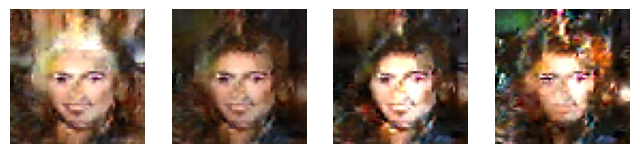

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.1482 - Gen Loss: 4.1714
Epoch 416/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - Disc Loss: 0.1414 - Gen Loss: 4.6414

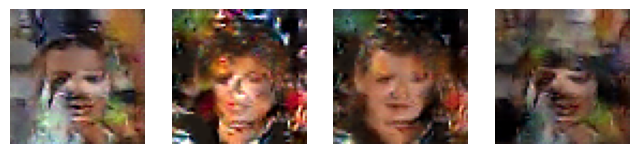

163/163 ━━━━━━━━━━━━━━━━━━━━ 41s 177ms/step - Disc Loss: 0.1414 - Gen Loss: 4.6347
Epoch 417/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1521 - Gen Loss: 4.6396

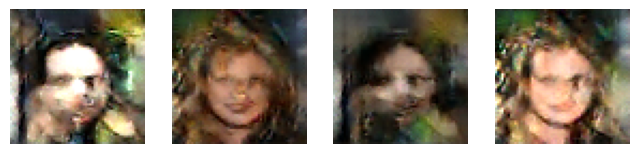

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 181ms/step - Disc Loss: 0.1524 - Gen Loss: 4.6391
Epoch 418/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - Disc Loss: 0.1650 - Gen Loss: 4.5622

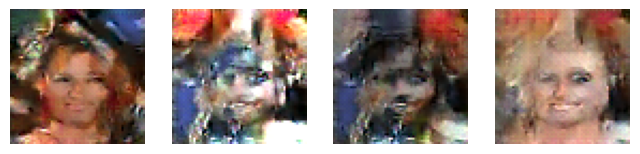

163/163 ━━━━━━━━━━━━━━━━━━━━ 34s 205ms/step - Disc Loss: 0.1654 - Gen Loss: 4.5563
Epoch 419/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1962 - Gen Loss: 4.4307

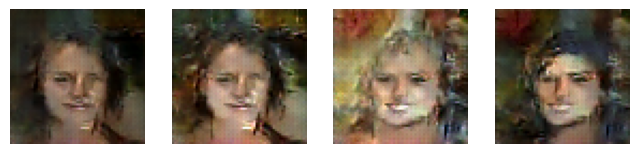

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 181ms/step - Disc Loss: 0.1969 - Gen Loss: 4.4296
Epoch 420/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step - Disc Loss: 0.1927 - Gen Loss: 4.7628

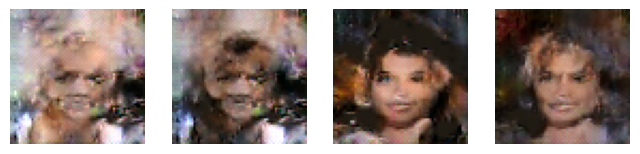

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 186ms/step - Disc Loss: 0.1921 - Gen Loss: 4.7625
Epoch 421/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - Disc Loss: 0.1697 - Gen Loss: 4.4543

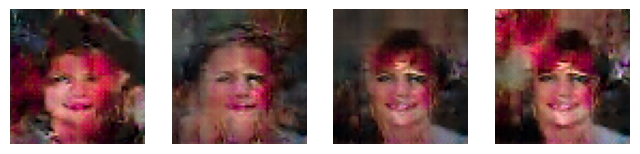

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 184ms/step - Disc Loss: 0.1690 - Gen Loss: 4.4629
Epoch 422/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - Disc Loss: 0.1772 - Gen Loss: 5.2054

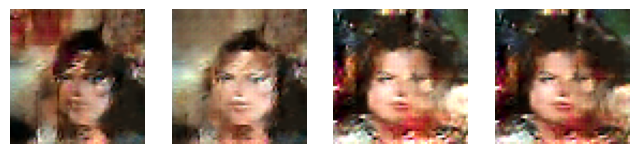

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 180ms/step - Disc Loss: 0.1768 - Gen Loss: 5.2045
Epoch 423/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - Disc Loss: 0.2033 - Gen Loss: 4.6761

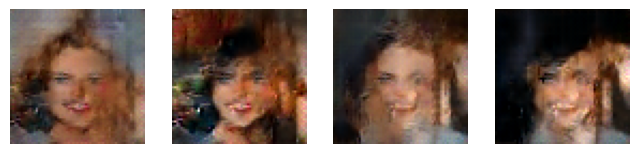

163/163 ━━━━━━━━━━━━━━━━━━━━ 29s 173ms/step - Disc Loss: 0.2034 - Gen Loss: 4.6690
Epoch 424/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.1793 - Gen Loss: 4.3092

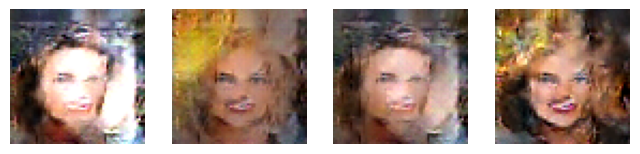

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 177ms/step - Disc Loss: 0.1797 - Gen Loss: 4.3064
Epoch 425/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - Disc Loss: 0.1804 - Gen Loss: 4.3748

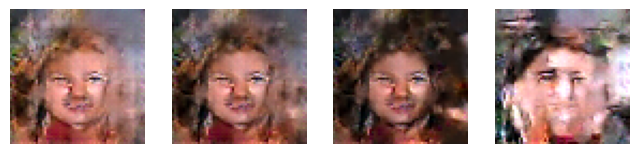

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 180ms/step - Disc Loss: 0.1806 - Gen Loss: 4.3744
Epoch 426/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1618 - Gen Loss: 4.6406

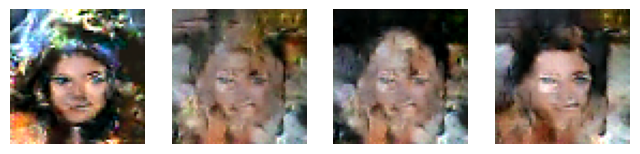

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.1618 - Gen Loss: 4.6402
Epoch 427/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.1792 - Gen Loss: 4.6416

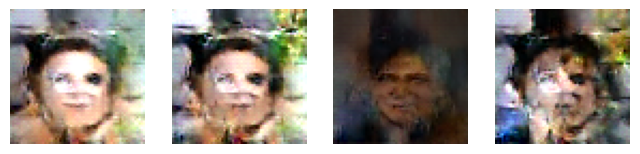

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 177ms/step - Disc Loss: 0.1789 - Gen Loss: 4.6459
Epoch 428/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - Disc Loss: 0.1683 - Gen Loss: 4.5907

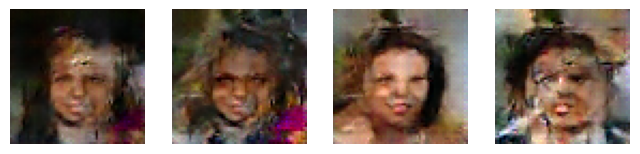

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 176ms/step - Disc Loss: 0.1676 - Gen Loss: 4.5948
Epoch 429/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - Disc Loss: 0.1858 - Gen Loss: 5.5700

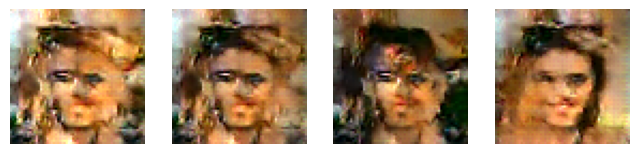

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 178ms/step - Disc Loss: 0.1859 - Gen Loss: 5.5770
Epoch 430/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1875 - Gen Loss: 5.1824

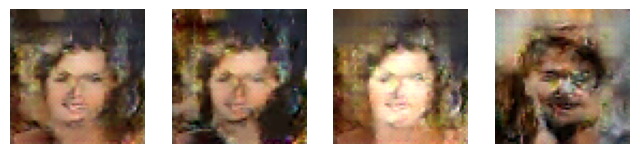

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.1872 - Gen Loss: 5.1755
Epoch 431/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - Disc Loss: 0.1553 - Gen Loss: 4.6570

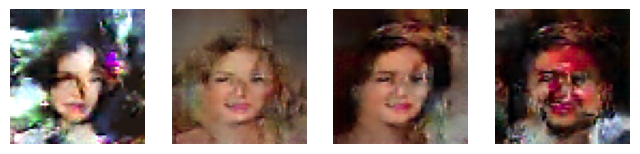

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.1548 - Gen Loss: 4.6639
Epoch 432/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step - Disc Loss: 0.1748 - Gen Loss: 4.5212

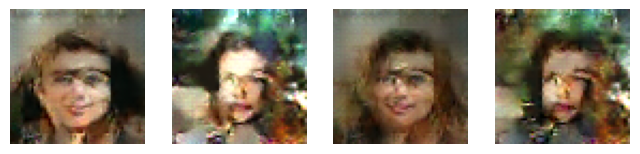

163/163 ━━━━━━━━━━━━━━━━━━━━ 28s 167ms/step - Disc Loss: 0.1746 - Gen Loss: 4.5287
Epoch 433/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - Disc Loss: 0.1555 - Gen Loss: 4.7696

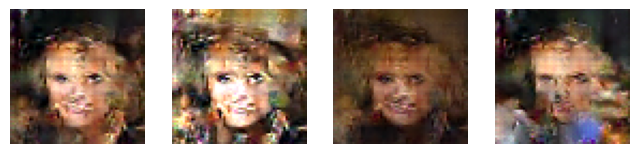

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 181ms/step - Disc Loss: 0.1553 - Gen Loss: 4.7736
Epoch 434/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.2692 - Gen Loss: 4.8518

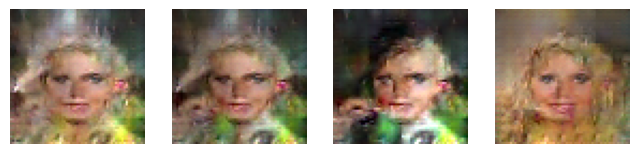

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 181ms/step - Disc Loss: 0.2693 - Gen Loss: 4.8499
Epoch 435/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.2186 - Gen Loss: 4.5740

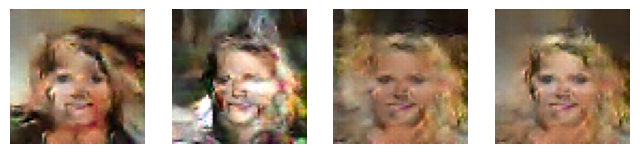

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 178ms/step - Disc Loss: 0.2183 - Gen Loss: 4.5739
Epoch 436/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - Disc Loss: 0.2025 - Gen Loss: 4.3429

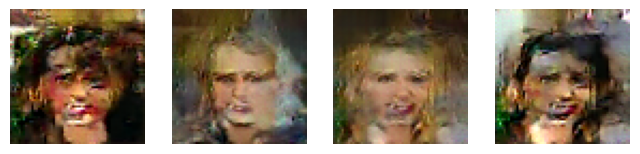

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 180ms/step - Disc Loss: 0.2024 - Gen Loss: 4.3427
Epoch 437/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1785 - Gen Loss: 4.5308

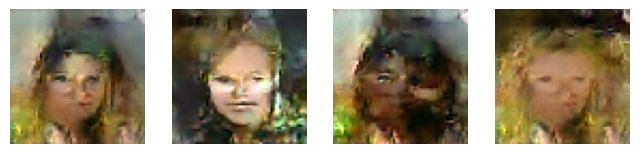

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.1783 - Gen Loss: 4.5331
Epoch 438/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - Disc Loss: 0.1846 - Gen Loss: 4.3097

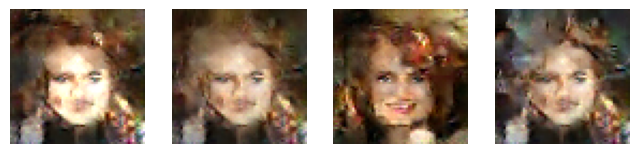

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 180ms/step - Disc Loss: 0.1850 - Gen Loss: 4.3083
Epoch 439/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1749 - Gen Loss: 4.3448

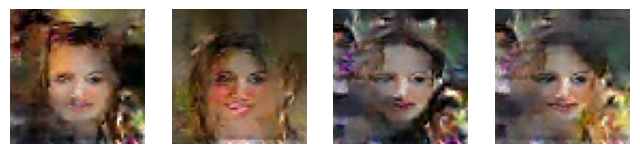

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.1744 - Gen Loss: 4.3462
Epoch 440/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - Disc Loss: 0.1817 - Gen Loss: 4.3242

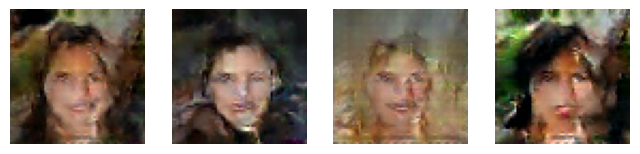

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 176ms/step - Disc Loss: 0.1814 - Gen Loss: 4.3268
Epoch 441/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step - Disc Loss: 0.1466 - Gen Loss: 4.5585

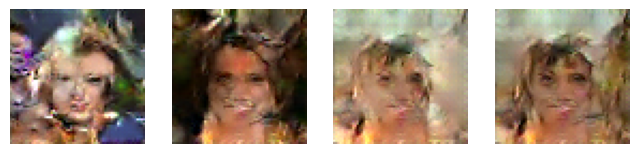

163/163 ━━━━━━━━━━━━━━━━━━━━ 29s 172ms/step - Disc Loss: 0.1464 - Gen Loss: 4.5594
Epoch 442/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1814 - Gen Loss: 4.3056

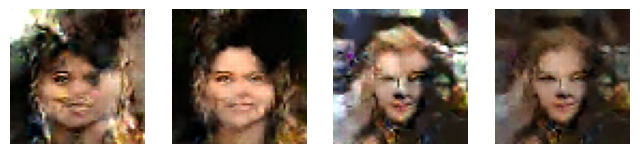

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 179ms/step - Disc Loss: 0.1811 - Gen Loss: 4.3075
Epoch 443/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - Disc Loss: 0.1927 - Gen Loss: 4.3454

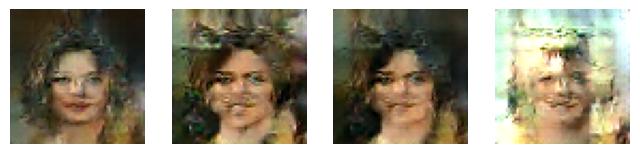

163/163 ━━━━━━━━━━━━━━━━━━━━ 29s 175ms/step - Disc Loss: 0.1923 - Gen Loss: 4.3513
Epoch 444/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.1602 - Gen Loss: 4.5526

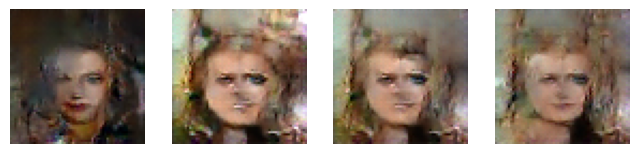

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 177ms/step - Disc Loss: 0.1597 - Gen Loss: 4.5506
Epoch 445/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.1689 - Gen Loss: 4.7524

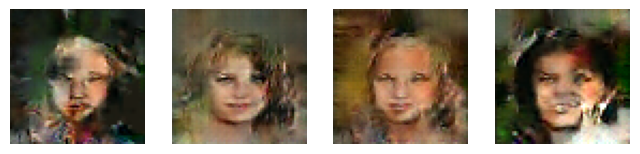

163/163 ━━━━━━━━━━━━━━━━━━━━ 42s 177ms/step - Disc Loss: 0.1692 - Gen Loss: 4.7546
Epoch 446/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - Disc Loss: 0.2111 - Gen Loss: 4.7653

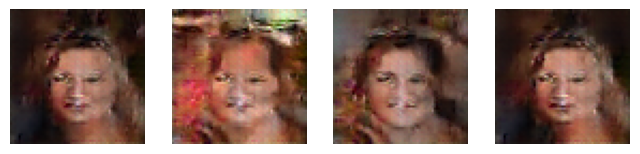

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 176ms/step - Disc Loss: 0.2111 - Gen Loss: 4.7675
Epoch 447/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - Disc Loss: 0.1713 - Gen Loss: 4.5375

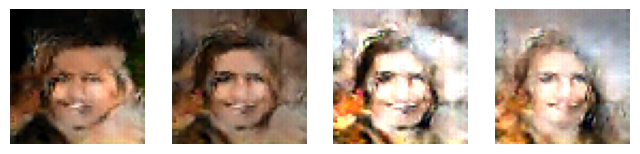

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 176ms/step - Disc Loss: 0.1711 - Gen Loss: 4.5352
Epoch 448/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - Disc Loss: 0.1312 - Gen Loss: 4.2856

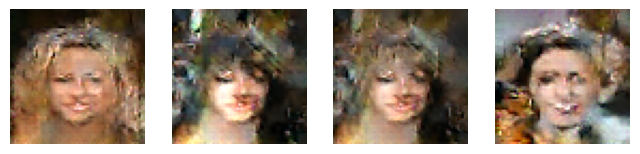

163/163 ━━━━━━━━━━━━━━━━━━━━ 29s 175ms/step - Disc Loss: 0.1311 - Gen Loss: 4.2867
Epoch 449/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - Disc Loss: 0.1693 - Gen Loss: 4.3312

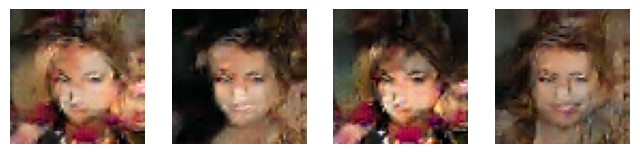

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.1706 - Gen Loss: 4.3293
Epoch 450/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step - Disc Loss: 0.1907 - Gen Loss: 4.6140

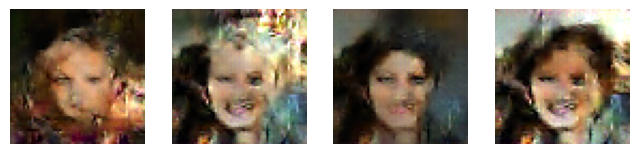

163/163 ━━━━━━━━━━━━━━━━━━━━ 29s 175ms/step - Disc Loss: 0.1902 - Gen Loss: 4.6148
Epoch 451/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.1618 - Gen Loss: 4.5359

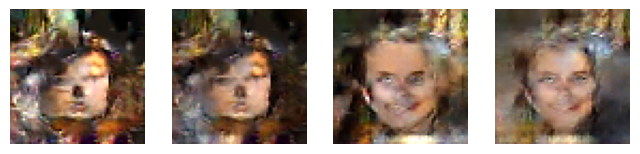

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 177ms/step - Disc Loss: 0.1627 - Gen Loss: 4.5331
Epoch 452/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - Disc Loss: 0.2059 - Gen Loss: 5.1762

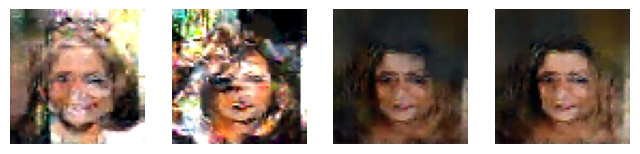

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 183ms/step - Disc Loss: 0.2056 - Gen Loss: 5.1804
Epoch 453/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.1768 - Gen Loss: 4.3831

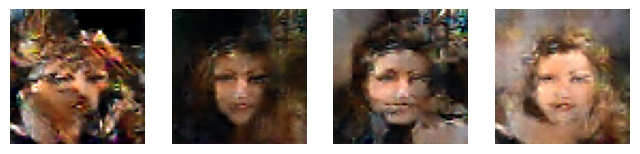

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 177ms/step - Disc Loss: 0.1762 - Gen Loss: 4.3879
Epoch 454/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - Disc Loss: 0.1482 - Gen Loss: 4.6752

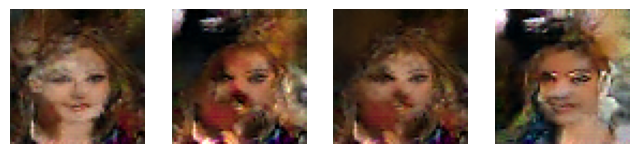

163/163 ━━━━━━━━━━━━━━━━━━━━ 33s 175ms/step - Disc Loss: 0.1483 - Gen Loss: 4.6722
Epoch 455/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - Disc Loss: 0.1846 - Gen Loss: 4.7032

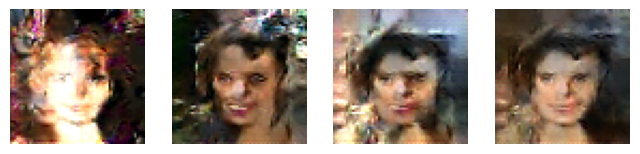

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 178ms/step - Disc Loss: 0.1859 - Gen Loss: 4.6943
Epoch 456/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step - Disc Loss: 0.1730 - Gen Loss: 4.4490

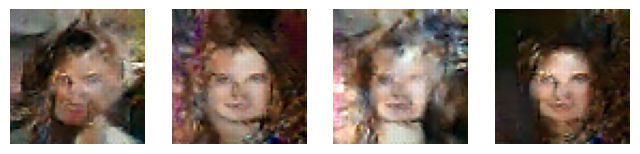

163/163 ━━━━━━━━━━━━━━━━━━━━ 29s 173ms/step - Disc Loss: 0.1727 - Gen Loss: 4.4508
Epoch 457/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - Disc Loss: 0.1504 - Gen Loss: 4.5706

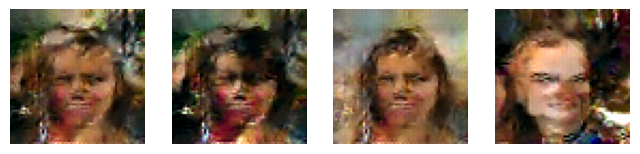

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 184ms/step - Disc Loss: 0.1509 - Gen Loss: 4.5697
Epoch 458/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1591 - Gen Loss: 4.4955

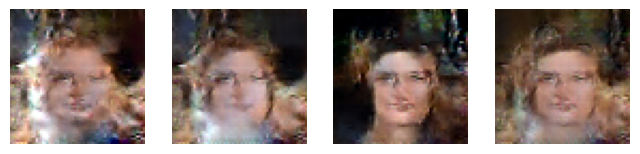

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.1589 - Gen Loss: 4.4957
Epoch 459/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.1649 - Gen Loss: 4.5322

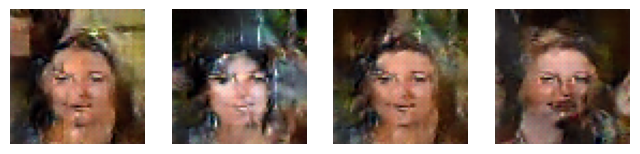

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 178ms/step - Disc Loss: 0.1644 - Gen Loss: 4.5276
Epoch 460/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step - Disc Loss: 0.1792 - Gen Loss: 4.7021

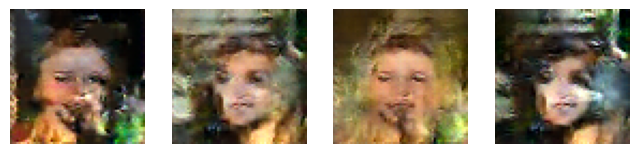

163/163 ━━━━━━━━━━━━━━━━━━━━ 33s 196ms/step - Disc Loss: 0.1786 - Gen Loss: 4.7088
Epoch 461/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - Disc Loss: 0.1756 - Gen Loss: 4.6314

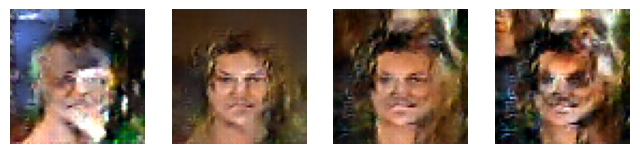

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 182ms/step - Disc Loss: 0.1758 - Gen Loss: 4.6333
Epoch 462/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1466 - Gen Loss: 4.8555

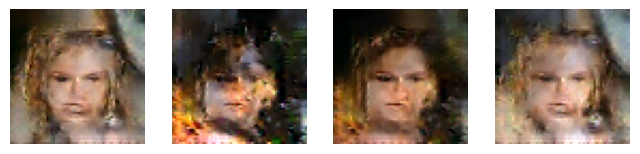

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 181ms/step - Disc Loss: 0.1473 - Gen Loss: 4.8558
Epoch 463/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - Disc Loss: 0.1787 - Gen Loss: 5.2442

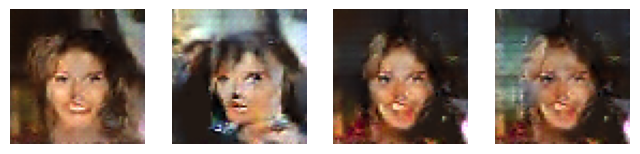

163/163 ━━━━━━━━━━━━━━━━━━━━ 32s 184ms/step - Disc Loss: 0.1786 - Gen Loss: 5.2410
Epoch 464/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step - Disc Loss: 0.1390 - Gen Loss: 4.5732

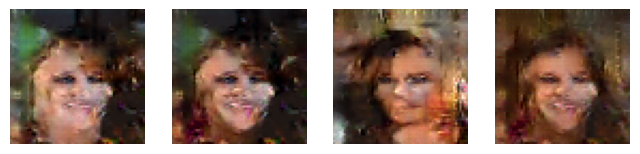

163/163 ━━━━━━━━━━━━━━━━━━━━ 29s 170ms/step - Disc Loss: 0.1388 - Gen Loss: 4.5736
Epoch 465/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - Disc Loss: 0.1471 - Gen Loss: 4.6631

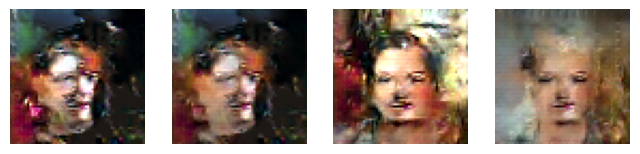

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 185ms/step - Disc Loss: 0.1467 - Gen Loss: 4.6620
Epoch 466/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1488 - Gen Loss: 4.7327

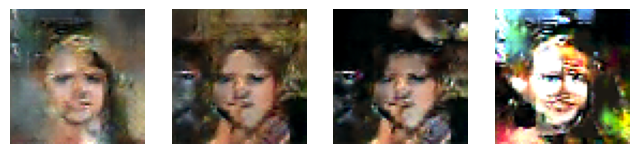

163/163 ━━━━━━━━━━━━━━━━━━━━ 41s 181ms/step - Disc Loss: 0.1488 - Gen Loss: 4.7329
Epoch 467/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - Disc Loss: 0.1842 - Gen Loss: 4.8282

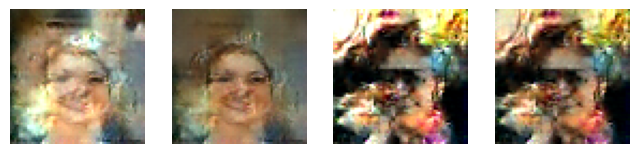

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 176ms/step - Disc Loss: 0.1846 - Gen Loss: 4.8174
Epoch 468/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.2421 - Gen Loss: 4.9135

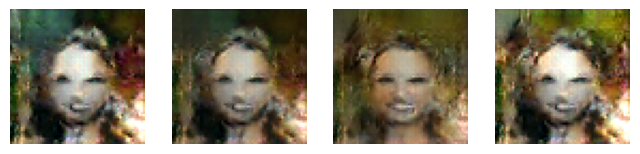

163/163 ━━━━━━━━━━━━━━━━━━━━ 42s 179ms/step - Disc Loss: 0.2418 - Gen Loss: 4.9124
Epoch 469/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - Disc Loss: 0.1972 - Gen Loss: 4.3718

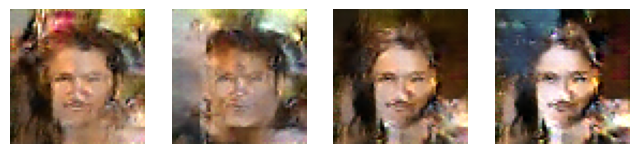

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 176ms/step - Disc Loss: 0.1974 - Gen Loss: 4.3678
Epoch 470/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step - Disc Loss: 0.1813 - Gen Loss: 4.2093

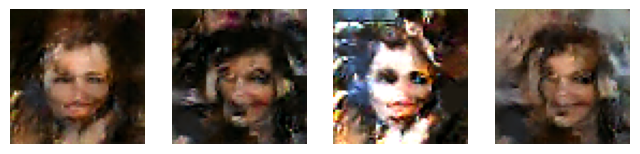

163/163 ━━━━━━━━━━━━━━━━━━━━ 32s 189ms/step - Disc Loss: 0.1811 - Gen Loss: 4.2074
Epoch 471/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - Disc Loss: 0.1449 - Gen Loss: 5.0593

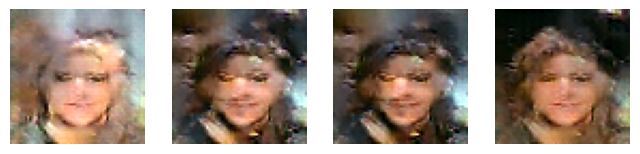

163/163 ━━━━━━━━━━━━━━━━━━━━ 40s 185ms/step - Disc Loss: 0.1452 - Gen Loss: 5.0641
Epoch 472/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - Disc Loss: 0.1663 - Gen Loss: 4.7253

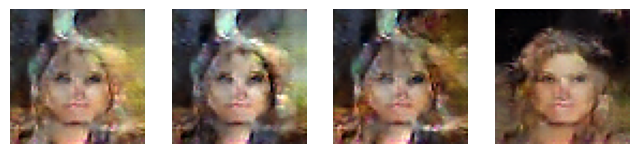

163/163 ━━━━━━━━━━━━━━━━━━━━ 40s 181ms/step - Disc Loss: 0.1669 - Gen Loss: 4.7199
Epoch 473/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - Disc Loss: 0.1369 - Gen Loss: 4.7955

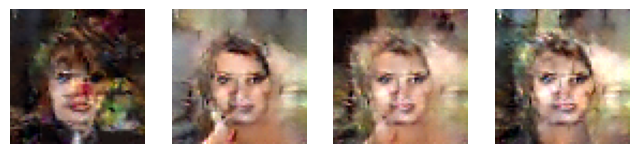

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 181ms/step - Disc Loss: 0.1367 - Gen Loss: 4.7925
Epoch 474/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - Disc Loss: 0.1537 - Gen Loss: 4.3397

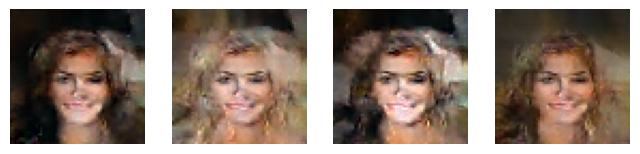

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 181ms/step - Disc Loss: 0.1532 - Gen Loss: 4.3420
Epoch 475/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1602 - Gen Loss: 4.4918

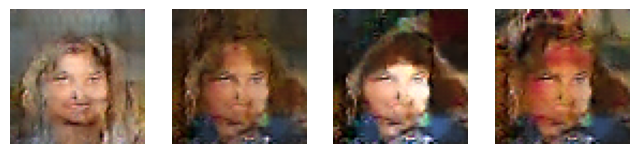

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 182ms/step - Disc Loss: 0.1599 - Gen Loss: 4.4940
Epoch 476/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - Disc Loss: 0.1740 - Gen Loss: 5.0287

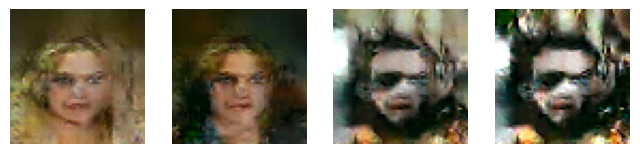

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 178ms/step - Disc Loss: 0.1736 - Gen Loss: 5.0230
Epoch 477/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1913 - Gen Loss: 5.4372

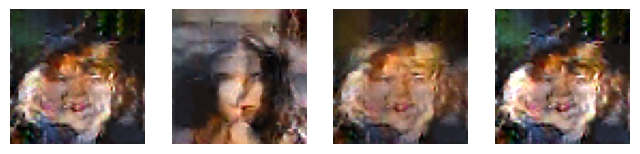

163/163 ━━━━━━━━━━━━━━━━━━━━ 41s 179ms/step - Disc Loss: 0.1913 - Gen Loss: 5.4334
Epoch 478/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - Disc Loss: 0.2045 - Gen Loss: 5.0621

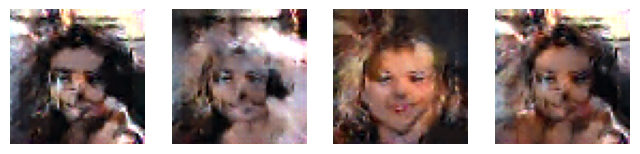

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 178ms/step - Disc Loss: 0.2042 - Gen Loss: 5.0591
Epoch 479/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - Disc Loss: 0.1581 - Gen Loss: 4.7554

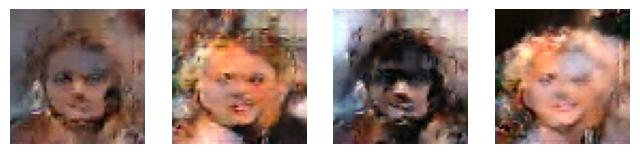

163/163 ━━━━━━━━━━━━━━━━━━━━ 41s 180ms/step - Disc Loss: 0.1578 - Gen Loss: 4.7574
Epoch 480/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.1294 - Gen Loss: 4.7829

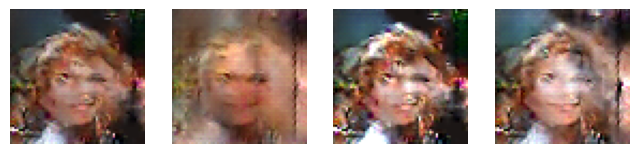

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 178ms/step - Disc Loss: 0.1292 - Gen Loss: 4.7839
Epoch 481/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step - Disc Loss: 0.1412 - Gen Loss: 4.7857

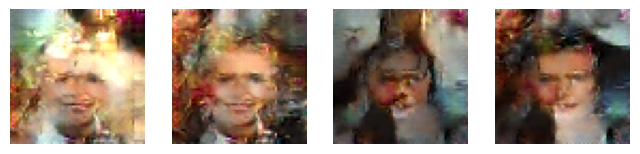

163/163 ━━━━━━━━━━━━━━━━━━━━ 32s 188ms/step - Disc Loss: 0.1414 - Gen Loss: 4.7864
Epoch 482/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.2735 - Gen Loss: 5.9741

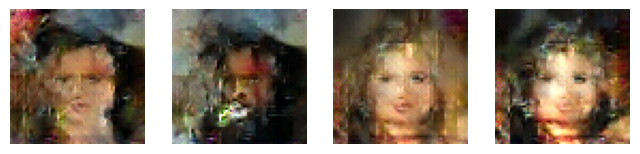

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 181ms/step - Disc Loss: 0.2733 - Gen Loss: 5.9599
Epoch 483/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - Disc Loss: 0.2263 - Gen Loss: 4.5580

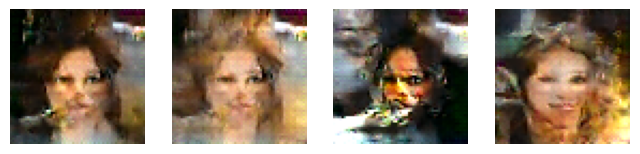

163/163 ━━━━━━━━━━━━━━━━━━━━ 36s 211ms/step - Disc Loss: 0.2257 - Gen Loss: 4.5610
Epoch 484/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.2202 - Gen Loss: 4.8204

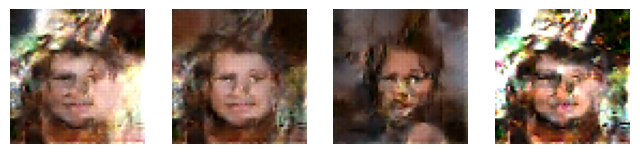

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 181ms/step - Disc Loss: 0.2217 - Gen Loss: 4.8214
Epoch 485/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - Disc Loss: 0.2126 - Gen Loss: 4.5645

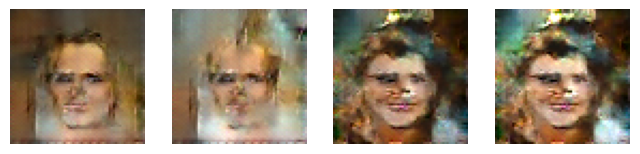

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 180ms/step - Disc Loss: 0.2121 - Gen Loss: 4.5668
Epoch 486/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step - Disc Loss: 0.2179 - Gen Loss: 4.7278

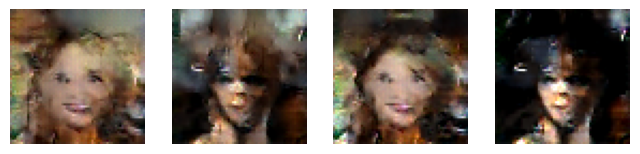

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 177ms/step - Disc Loss: 0.2172 - Gen Loss: 4.7249
Epoch 487/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step - Disc Loss: 0.1895 - Gen Loss: 4.4512

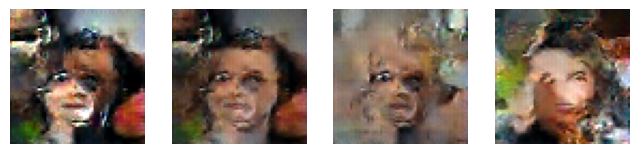

163/163 ━━━━━━━━━━━━━━━━━━━━ 32s 191ms/step - Disc Loss: 0.1894 - Gen Loss: 4.4531
Epoch 488/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1578 - Gen Loss: 4.8080

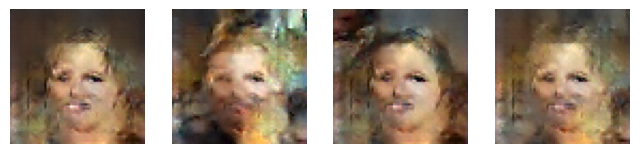

163/163 ━━━━━━━━━━━━━━━━━━━━ 32s 180ms/step - Disc Loss: 0.1578 - Gen Loss: 4.8130
Epoch 489/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - Disc Loss: 0.1618 - Gen Loss: 5.0929

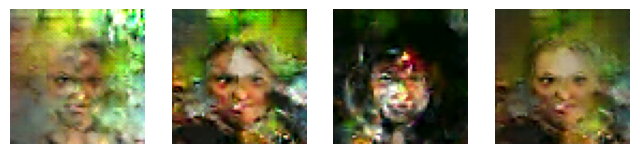

163/163 ━━━━━━━━━━━━━━━━━━━━ 32s 185ms/step - Disc Loss: 0.1612 - Gen Loss: 5.1113
Epoch 490/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step - Disc Loss: 0.1552 - Gen Loss: 5.1311

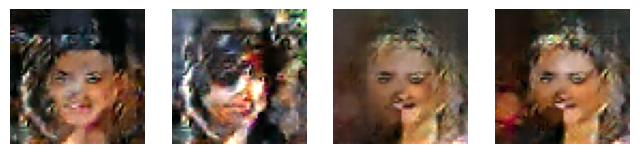

163/163 ━━━━━━━━━━━━━━━━━━━━ 32s 187ms/step - Disc Loss: 0.1551 - Gen Loss: 5.1299
Epoch 491/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1454 - Gen Loss: 5.1700

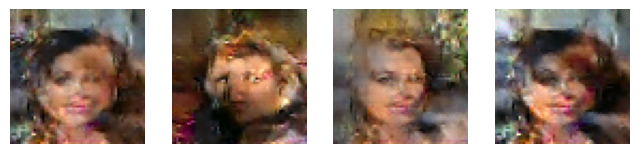

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 181ms/step - Disc Loss: 0.1455 - Gen Loss: 5.1704
Epoch 492/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - Disc Loss: 0.2095 - Gen Loss: 5.1204

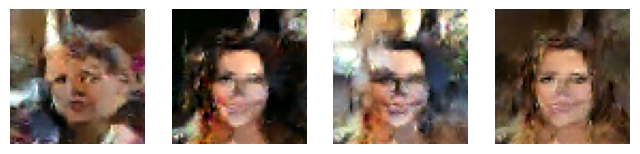

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 185ms/step - Disc Loss: 0.2097 - Gen Loss: 5.1170
Epoch 493/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - Disc Loss: 0.1806 - Gen Loss: 4.4291

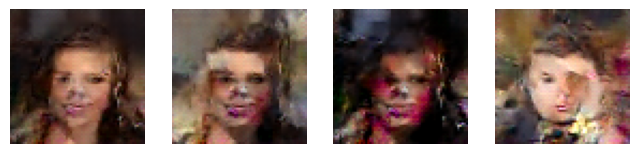

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 181ms/step - Disc Loss: 0.1803 - Gen Loss: 4.4269
Epoch 494/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - Disc Loss: 0.1771 - Gen Loss: 4.3922

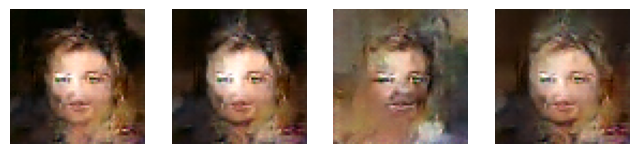

163/163 ━━━━━━━━━━━━━━━━━━━━ 41s 185ms/step - Disc Loss: 0.1768 - Gen Loss: 4.3929
Epoch 495/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - Disc Loss: 0.1816 - Gen Loss: 4.5168

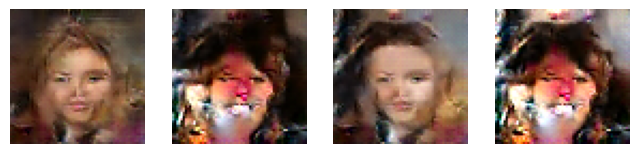

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 185ms/step - Disc Loss: 0.1817 - Gen Loss: 4.5187
Epoch 496/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.1499 - Gen Loss: 4.8396

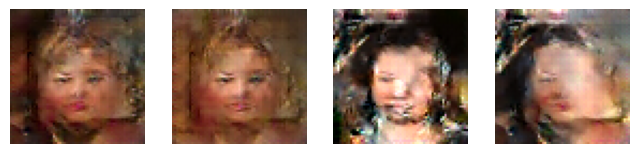

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.1500 - Gen Loss: 4.8402
Epoch 497/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - Disc Loss: 0.3107 - Gen Loss: 6.0511

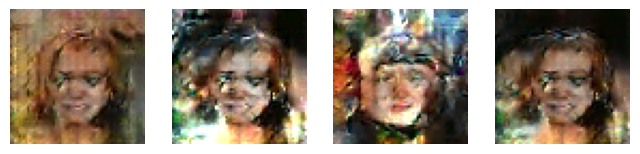

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 180ms/step - Disc Loss: 0.3099 - Gen Loss: 6.0402
Epoch 498/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step - Disc Loss: 0.3076 - Gen Loss: 4.8832

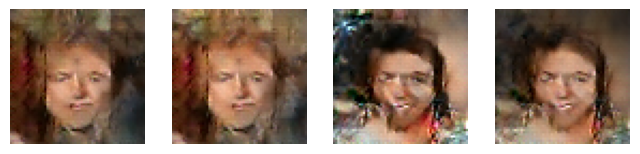

163/163 ━━━━━━━━━━━━━━━━━━━━ 30s 179ms/step - Disc Loss: 0.3071 - Gen Loss: 4.8767
Epoch 499/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - Disc Loss: 0.2199 - Gen Loss: 3.9846

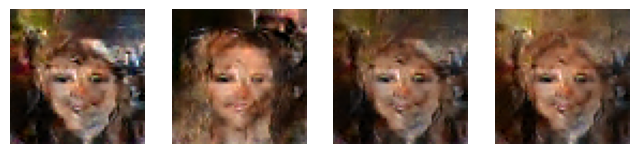

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 183ms/step - Disc Loss: 0.2200 - Gen Loss: 3.9857
Epoch 500/500
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - Disc Loss: 0.1813 - Gen Loss: 4.3880

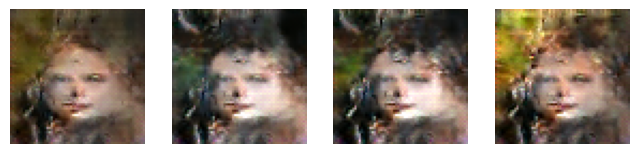

163/163 ━━━━━━━━━━━━━━━━━━━━ 31s 183ms/step - Disc Loss: 0.1812 - Gen Loss: 4.3916


In [9]:
disc_model=Discriminator(LATENT_DIM)
gen_model=Generator(LATENT_DIM)

gan=GAN(discriminator=disc_model,generator=gen_model,latent_dim=LATENT_DIM)
gan.compile(
    disc_optimizer=disc_optimizer,
    gen_optimizer=gen_optimizer,
    loss_fn=cross_entropy,
    batch_size=batch_size
)

training_callback=Training_Callback(latent_dim=LATENT_DIM)
gan.fit(
    celebA_dataset,
    epochs=epochs,
    callbacks=[training_callback]
)


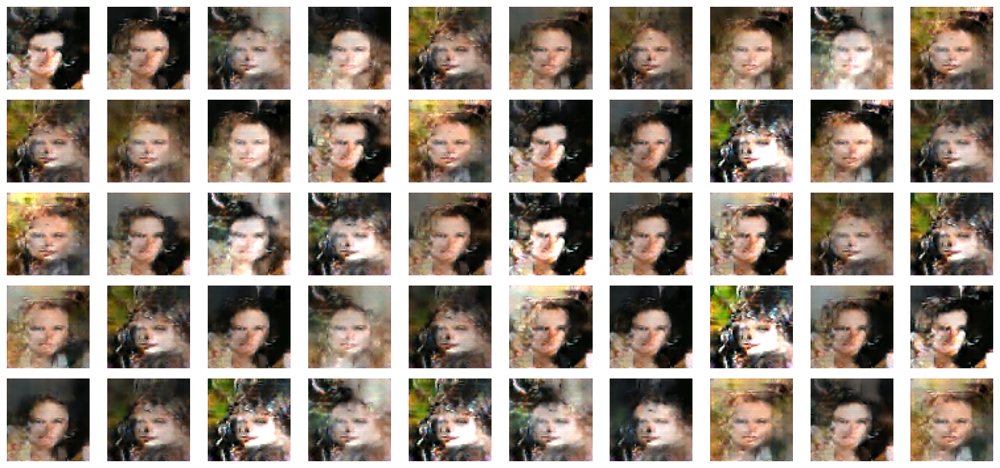

In [10]:
random_latent_vectors=tf.random.normal([50,LATENT_DIM])
generated_images=gen_model(random_latent_vectors,training=False)

fig, axes = plt.subplots(5, 10, figsize=(15, 7))  # 5 rows, 10 columns
for i, ax in enumerate(axes.flatten()):
    ax.imshow(generated_images[i])
    ax.axis('off')

plt.tight_layout()
plt.show()